# ТЕСТ 11 Дообучение

In [1]:
import keras
import tensorflow as tf
from keras import layers
from keras import ops

import os
import numpy as np
from glob import glob
import cv2
from scipy.io import loadmat
import matplotlib.pyplot as plt

# For data preprocessing
from tensorflow import image as tf_image
from tensorflow import data as tf_data
from tensorflow import io as tf_io

# Creating Dataset

In [2]:
CLASSES = [
    'фон',
    'гвоздика',
    'ирис',
    'пион'
]

colormap = [
    [0, 0, 0],
    [253, 156, 204],
    [91, 85, 144],
    [250, 50, 83],
]


IMAGE_SIZE = 512
BATCH_SIZE = 4
NUM_CLASSES = len(CLASSES)
DATA_DIR = "C:/Users/iraor/PycharmProjects/FusionBrainGen/flowers"
NUM_TRAIN_IMAGES = 160
NUM_VAL_IMAGES = 100
NUM_TEST_IMAGES = 10

train_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[:NUM_TRAIN_IMAGES]
train_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[:NUM_TRAIN_IMAGES]
val_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
val_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
test_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[NUM_VAL_IMAGES + NUM_TRAIN_IMAGES : NUM_TEST_IMAGES + NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
test_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[NUM_VAL_IMAGES + NUM_TRAIN_IMAGES : NUM_TEST_IMAGES + NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]


def read_image(image_path, mask=False):
    image = tf_io.read_file(image_path)
    if mask:
        image = tf_image.decode_png(image, channels=1)
        image.set_shape([None, None, 1])
        image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf_image.decode_png(image, channels=3)
        image.set_shape([None, None, 3])
        image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    return image


def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask


def data_generator(image_list, mask_list):
    dataset = tf_data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf_data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset


train_dataset = data_generator(train_images, train_masks)
val_dataset = data_generator(val_images, val_masks)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)

Train Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 512, 512, 1), dtype=tf.float32, name=None))>
Val Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 512, 512, 1), dtype=tf.float32, name=None))>


# Building the DeepLabV3+ model

In [4]:

def convolution_block(
    block_input,
    num_filters=256,
    kernel_size=3,
    dilation_rate=1,
    use_bias=False,
):
    x = layers.Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer=keras.initializers.HeNormal(),
    )(block_input)
    x = layers.BatchNormalization()(x)
    return ops.nn.relu(x)


def DilatedSpatialPyramidPooling(dspp_input):
    dims = dspp_input.shape
    x = layers.AveragePooling2D(pool_size=(dims[-3], dims[-2]))(dspp_input)
    x = convolution_block(x, kernel_size=1, use_bias=True)
    out_pool = layers.UpSampling2D(
        size=(dims[-3] // x.shape[1], dims[-2] // x.shape[2]),
        interpolation="bilinear",
    )(x)

    out_1 = convolution_block(dspp_input, kernel_size=1, dilation_rate=1)
    out_6 = convolution_block(dspp_input, kernel_size=3, dilation_rate=6)
    out_12 = convolution_block(dspp_input, kernel_size=3, dilation_rate=12)
    out_18 = convolution_block(dspp_input, kernel_size=3, dilation_rate=18)

    x = layers.Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    output = convolution_block(x, kernel_size=1)
    return output


In [5]:

def DeeplabV3Plus(image_size, num_classes):
    model_input = keras.Input(shape=(image_size, image_size, 3))
    preprocessed = keras.applications.resnet50.preprocess_input(model_input)
    resnet50 = keras.applications.ResNet50(
        weights="imagenet", include_top=False, input_tensor=preprocessed
    )
    x = resnet50.get_layer("conv4_block6_2_relu").output
    x = DilatedSpatialPyramidPooling(x)

    input_a = layers.UpSampling2D(
        size=(image_size // 4 // x.shape[1], image_size // 4 // x.shape[2]),
        interpolation="bilinear",
    )(x)
    input_b = resnet50.get_layer("conv2_block3_2_relu").output
    input_b = convolution_block(input_b, num_filters=48, kernel_size=1)

    x = layers.Concatenate(axis=-1)([input_a, input_b])
    x = convolution_block(x)
    x = convolution_block(x)
    x = layers.UpSampling2D(
        size=(image_size // x.shape[1], image_size // x.shape[2]),
        interpolation="bilinear",
    )(x)
    model_output = layers.Conv2D(num_classes, kernel_size=(1, 1), padding="same")(x)
    return keras.Model(inputs=model_input, outputs=model_output)


model = DeeplabV3Plus(image_size=IMAGE_SIZE, num_classes=NUM_CLASSES)
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                  ┃ Output Shape              ┃     Param # ┃ Connected to                   ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)      │ (None, 512, 512, 3)       │           0 │ -                              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item (GetItem)            │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item_1 (GetItem)          │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ get_item_2 (GetItem)          │ (None, 512, 512)          │           0 │ input_layer[0][0]              │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ stack (Stack)                 │ (None, 512, 512, 3)       │           0 │ get_item[0][0],                │
│                               │                           │             │ get_item_1[0][0],              │
│                               │                           │             │ get_item_2[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ add (Add)                     │ (None, 512, 512, 3)       │           0 │ stack[0][0]                    │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_pad (ZeroPadding2D)     │ (None, 518, 518, 3)       │           0 │ add[0][0]                      │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_conv (Conv2D)           │ (None, 256, 256, 64)      │       9,472 │ conv1_pad[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_bn (BatchNormalization) │ (None, 256, 256, 64)      │         256 │ conv1_conv[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv1_relu (Activation)       │ (None, 256, 256, 64)      │           0 │ conv1_bn[0][0]                 │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ pool1_pad (ZeroPadding2D)     │ (None, 258, 258, 64)      │           0 │ conv1_relu[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ pool1_pool (MaxPooling2D)     │ (None, 128, 128, 64)      │           0 │ pool1_pad[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_conv (Conv2D)  │ (None, 128, 128, 64)      │       4,160 │ pool1_pool[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_bn             │ (None, 128, 128, 64)      │         256 │ conv2_block1_1_conv[0][0]      │
│ (BatchNormalization)          │                           │             │                                │
├───────────────────────────────┼───────────────────────────┼─────────────┼────────────────────────────────┤
│ conv2_block1_1_relu           │ (None, 128, 128, 64)      │           0 │ conv2_block1_1_bn[0][0]        │
│ (Activation)                  │                           │             │                                │
├───────────────────────────────┼───────────────────────────┼─────────────┼─

 Total params: 11,853,124 (45.22 MB)

 Trainable params: 11,820,388 (45.09 MB)

 Non-trainable params: 32,736 (127.88 KB)

# Training

In [6]:
class UpdatedIoU(tf.keras.metrics.IoU):
  def __init__(self,
               y_true=None,
               y_pred=None,
               num_classes=None,
               target_class_ids=None,
               name=None,
               dtype=None):
    super(UpdatedIoU, self).__init__(num_classes = num_classes, target_class_ids=target_class_ids, name=name, dtype=dtype)

  def update_state(self, y_true, y_pred, sample_weight=None):
    y_pred = tf.math.argmax(y_pred, axis=-1)
    return super().update_state(y_true, y_pred, sample_weight)

In [7]:
loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001),
    loss=loss,
    metrics=["accuracy", 
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0, 1, 2, 3], name='MIoU'),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[0], name=CLASSES[0]),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[1], name=CLASSES[1]),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[2], name=CLASSES[2]),
             UpdatedIoU(num_classes=len(CLASSES), target_class_ids=[3], name=CLASSES[3]),
            ],
)

history = model.fit(train_dataset, validation_data=val_dataset, epochs=5)

Epoch 1/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 529s 12s/step - MIoU: 0.2585 - accuracy: 0.8281 - loss: 0.5215 - гвоздика: 0.0047 - ирис: 0.0125 - пион: 0.1865 - фон: 0.8301 - val_MIoU: 0.0779 - val_accuracy: 0.2532 - val_loss: 11.0469 - val_гвоздика: 0.0170 - val_ирис: 0.0000e+00 - val_пион: 0.0769 - val_фон: 0.2177
Epoch 2/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 491s 12s/step - MIoU: 0.4542 - accuracy: 0.9551 - loss: 0.1377 - гвоздика: 0.1033 - ирис: 0.2571 - пион: 0.5005 - фон: 0.9561 - val_MIoU: 0.1017 - val_accuracy: 0.3042 - val_loss: 6.8173 - val_гвоздика: 0.0262 - val_ирис: 0.0377 - val_пион: 0.0755 - val_фон: 0.2674
Epoch 3/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 485s 12s/step - MIoU: 0.5568 - accuracy: 0.9602 - loss: 0.1112 - гвоздика: 0.3469 - ирис: 0.3638 - пион: 0.5549 - фон: 0.9616 - val_MIoU: 0.3620 - val_accuracy: 0.9306 - val_loss: 0.2346 - val_гвоздика: 0.0849 - val_ирис: 0.0520 - val_пион: 0.3810 - val_фон: 0.9300
Epoch 4/5
40/40 ━━━━━━━━━━━━━━━━━━━━ 483s 12s/step - MIoU: 0.7068 - accuracy: 0.9736 -

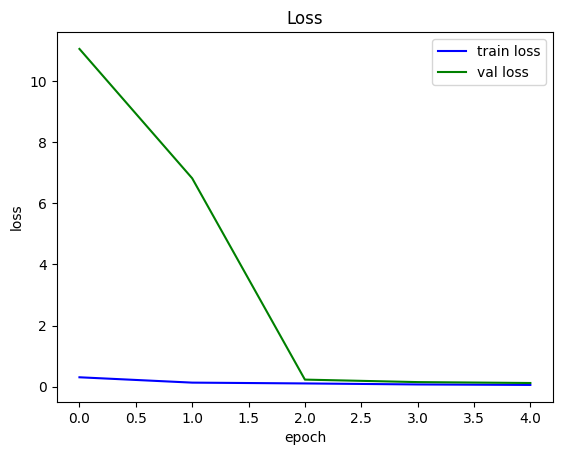

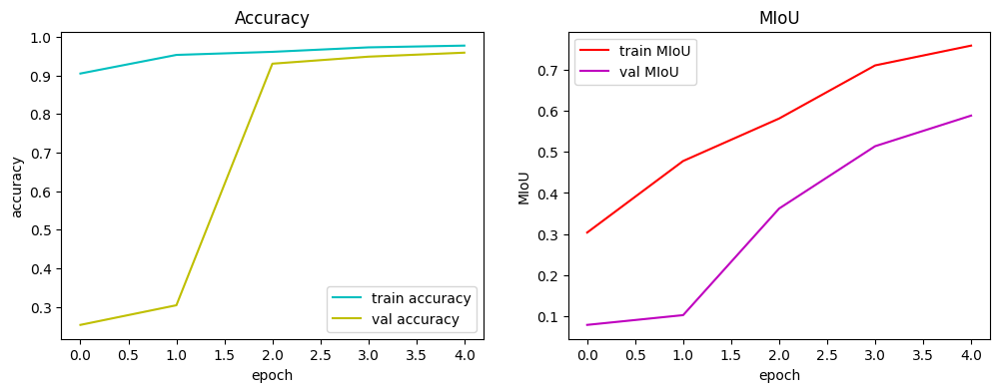

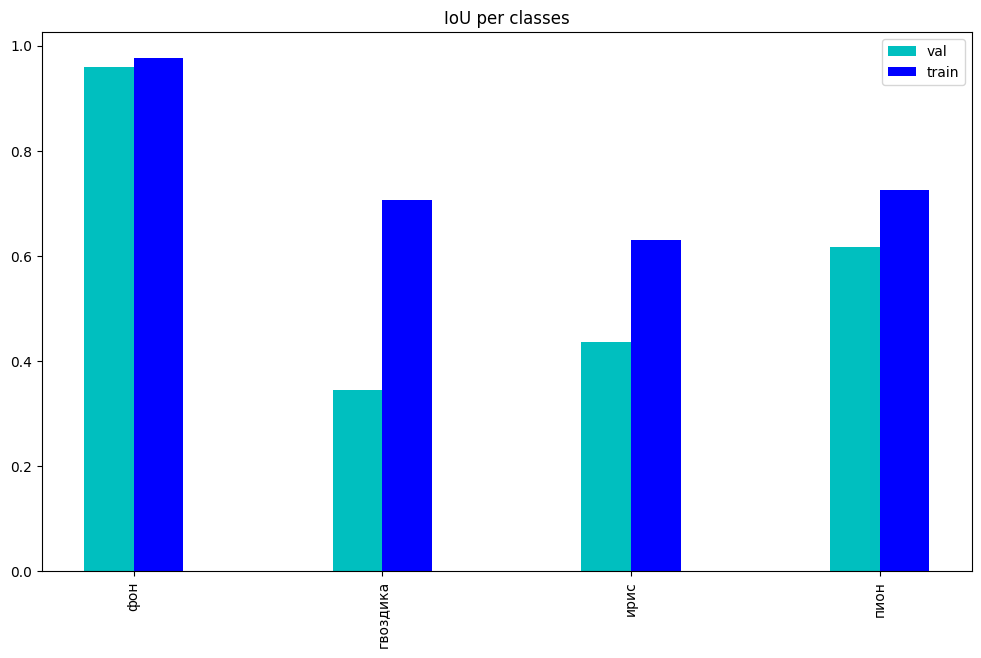

In [8]:
plt.plot(history.history["loss"], label = 'train loss', color = 'b')
plt.plot(history.history["val_loss"], label = 'val loss', color = 'g')
plt.title("Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.legend()
plt.show()


fig, axs = plt.subplots(1, 2, figsize=(12, 4))
axs[0].plot(history.history["accuracy"], label = 'train accuracy', color = 'c')
axs[0].plot(history.history["val_accuracy"], label = 'val accuracy', color = 'y')
axs[0].set_title("Accuracy")
axs[0].set_ylabel("accuracy")
axs[0].set_xlabel("epoch")
axs[0].legend()
axs[1].plot(history.history["MIoU"], label = 'train MIoU', color = 'r')
axs[1].plot(history.history["val_MIoU"], label = 'val MIoU', color = 'm')
axs[1].set_title("MIoU")
axs[1].set_ylabel("MIoU")
axs[1].set_xlabel("epoch")
axs[1].legend()
plt.show()

# fig, axs = plt.subplots(1, 2, figsize=(12, 4))
# axs[0].plot(history.history["фон"], label = 'фон IoU', color = 'black')
# axs[0].plot(history.history["череп"], label = 'череп IoU', color = 'b')
# axs[0].set_title("Train IOU per classes")
# axs[0].set_ylabel("IoU")
# axs[0].set_xlabel("epoch")
# axs[0].legend()
# axs[1].plot(history.history["val_фон"], label = 'фон IoU', color = 'black')
# axs[1].plot(history.history["val_череп"], label = 'череп IoU', color = 'b')
# axs[1].set_title("Val IOU per classes")
# axs[1].set_ylabel("IoU")
# axs[1].set_xlabel("epoch")
# axs[1].legend()
# plt.show()

train_values = [history.history["фон"][4], history.history["гвоздика"][4], history.history["ирис"][4], history.history["пион"][4]]
val_values = [history.history["val_фон"][4], history.history["val_гвоздика"][4], history.history["val_ирис"][4], history.history["val_пион"][4]]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (12, 7))
plt.title('IoU per classes')
plt.bar(x_axis-0.1, val_values, width=0.2, color='c', label='val')
plt.bar(x_axis+0.1, train_values, width=0.2, color='b', label='train')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.legend()
plt.show()

# Inference using Colormap Overlay



In [9]:
def infer(model, image_tensor):
    predictions = model.predict(np.expand_dims((image_tensor), axis=0))
    predictions = np.squeeze(predictions)
    predictions = np.argmax(predictions, axis=2)
    return predictions


def decode_segmentation_masks(mask, colormap, n_classes):
    r = np.zeros_like(mask).astype(np.uint8)
    g = np.zeros_like(mask).astype(np.uint8)
    b = np.zeros_like(mask).astype(np.uint8)

    # print(mask[250])

    
    for l in range(0, n_classes):
        idx = mask == l
        r[idx] = colormap[l][0]
        g[idx] = colormap[l][1]
        b[idx] = colormap[l][2]
    rgb = np.stack([r, g, b], axis=2)
    return rgb


def get_overlay(image, colored_mask):
    image = keras.utils.array_to_img(image)
    image = np.array(image).astype(np.uint8)
    overlay = cv2.addWeighted(image, 0.35, colored_mask, 0.65, 0)
    return overlay


def plot_samples_matplotlib(display_list, figsize=(5, 3)):
    _, axes = plt.subplots(nrows=1, ncols=len(display_list), figsize=figsize)
    for i in range(len(display_list)):
        if display_list[i].shape[-1] == 3:
            axes[i].imshow(keras.utils.array_to_img(display_list[i]))
        else:
            axes[i].imshow(display_list[i])
    plt.show()


def _predictions(images_list, colormap, mod, model):
    for image_file in images_list:
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, len(CLASSES))

        name = image_file.split("\\")[2]
        if mod == "test":
            if not (os.path.exists("C:/Users/iraor/PycharmProjects/FusionBrainGen/flowers/test_pred")):
                os.makedirs("C:/Users/iraor/PycharmProjects/FusionBrainGen/flowers/test_pred")
            path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/flowers/test_pred/{name}"
        pred_map = cv2.cvtColor(prediction_colormap, cv2.COLOR_BGR2RGB)
        cv2.imwrite(path, pred_map)
            

def plot_predictions(images_list, colormap, mod, model):
    for image_file in images_list:
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, len(CLASSES))

        # name = image_file.split("\\")[2]
        # if mod == "train":
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_kmeans_white/train_pred/{name}"
        # elif  mod == "val":
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_kmeans_white/val_pred/{name}"
        # else: 
        #     path = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes_kmeans_white/test_pred/{name}"
        # pred_map = cv2.cvtColor(prediction_colormap, cv2.COLOR_BGR2RGB)
        # cv2.imwrite(path, pred_map)
            
        overlay = get_overlay(image_tensor, prediction_colormap)
        plot_samples_matplotlib(
            [image_tensor, overlay, prediction_colormap], figsize=(18, 14)
        )

## Inference on Train Images

In [76]:
# _predictions(train_images, colormap, "train", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


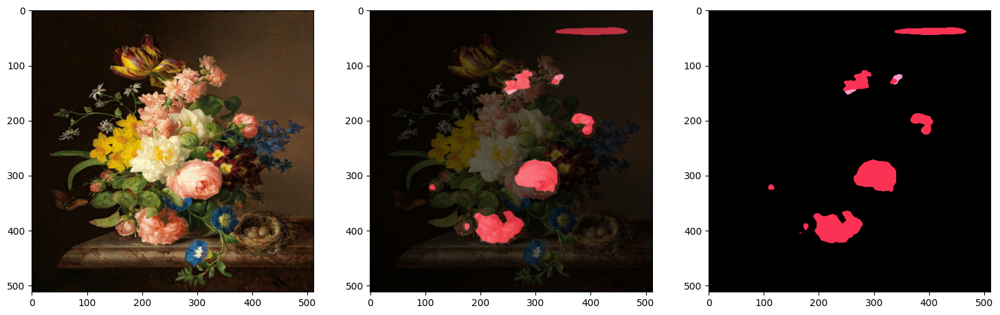

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 478ms/step


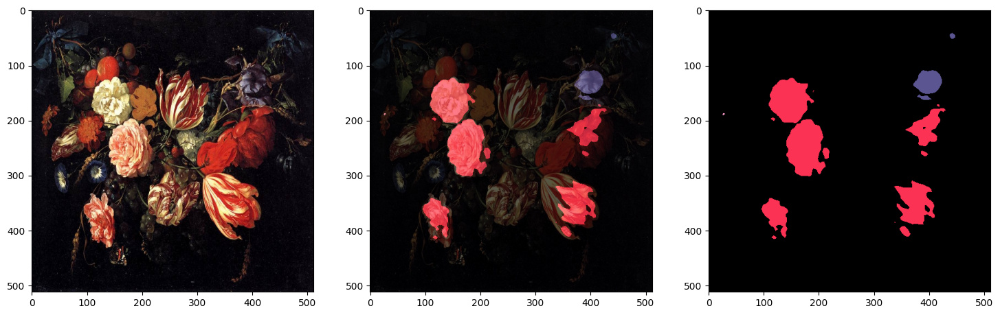

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


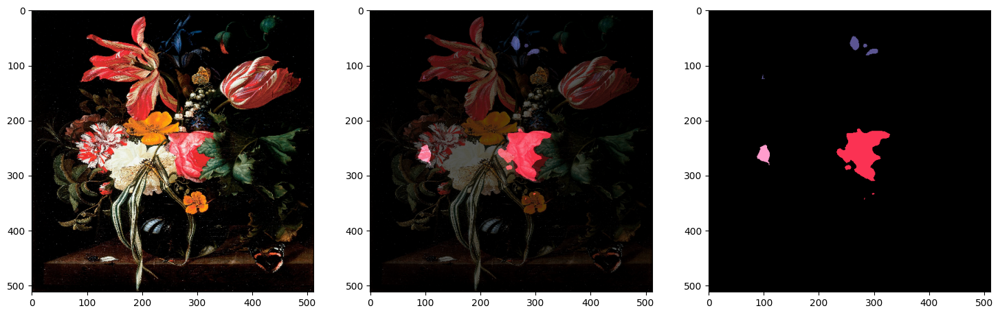

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step


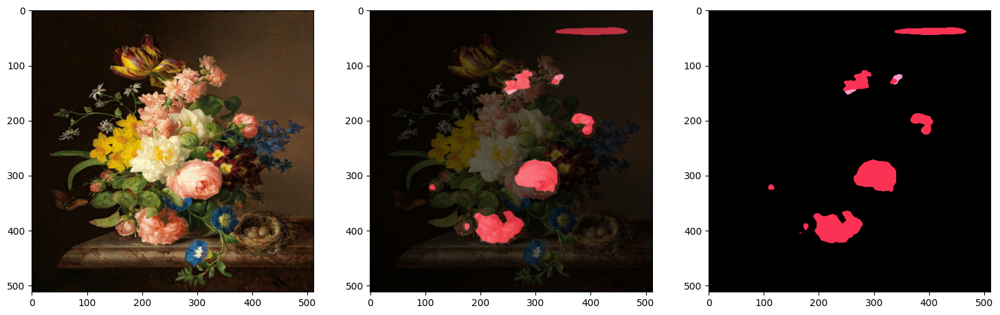

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step


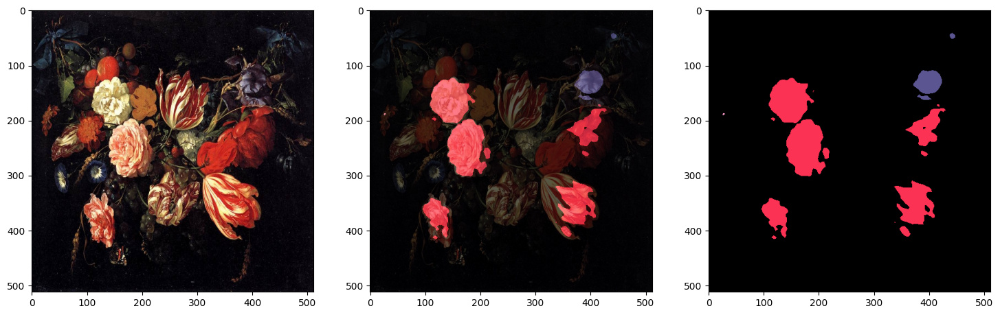

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 527ms/step


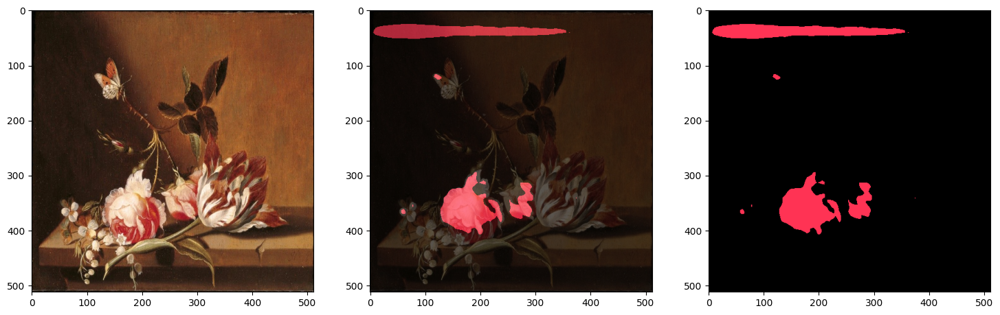

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 505ms/step


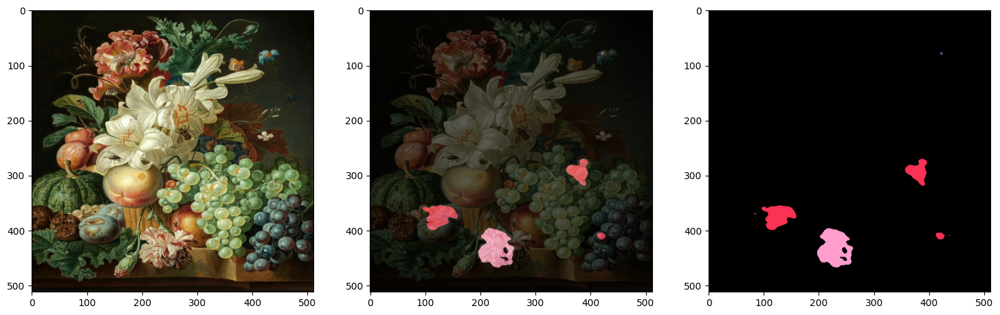

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 487ms/step


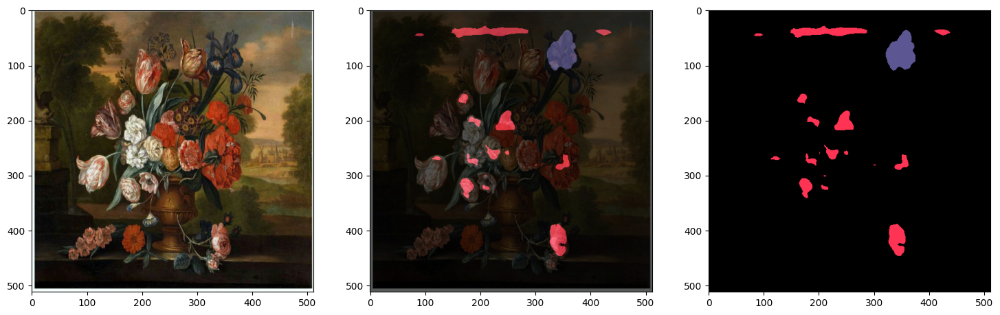

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


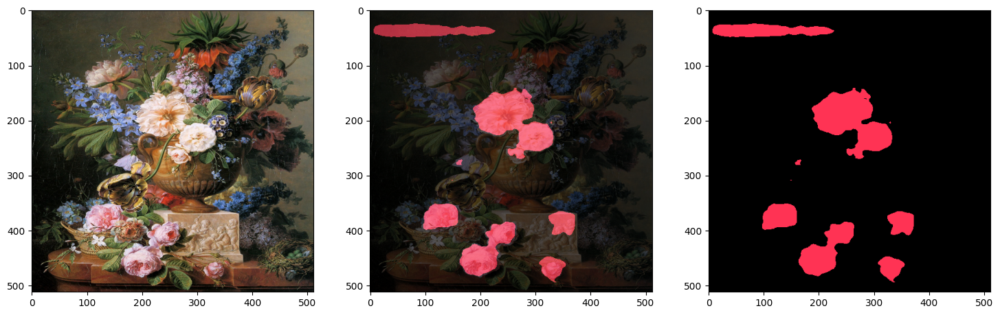

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


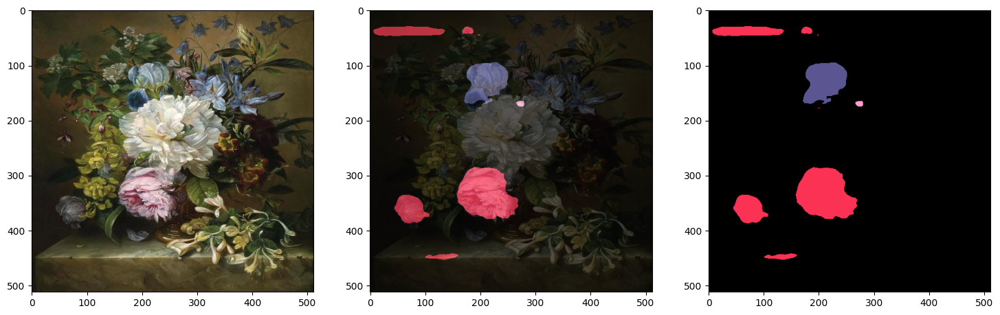

In [10]:
plot_predictions(train_images[:10], colormap, "train", model=model)

## Inference on Validation Images

In [78]:
# _predictions(val_images, colormap, "val", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


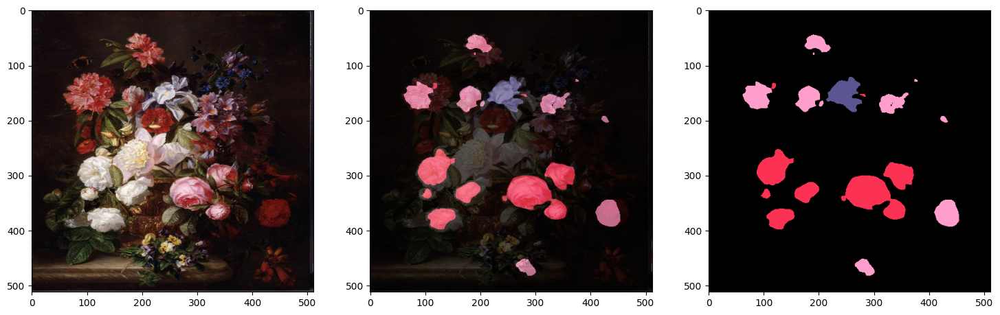

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step


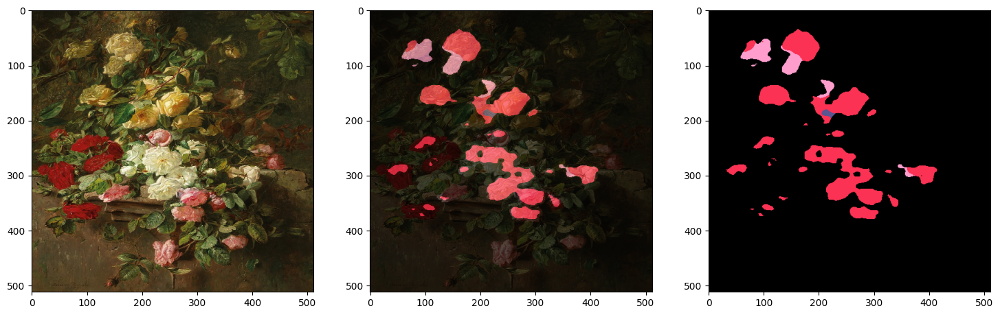

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step


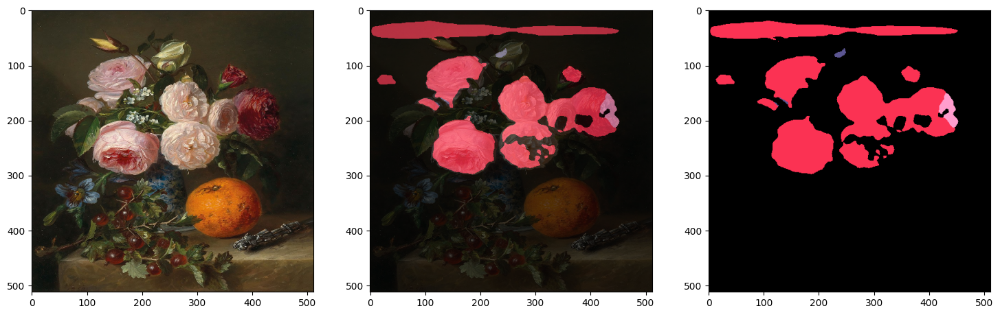

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 474ms/step


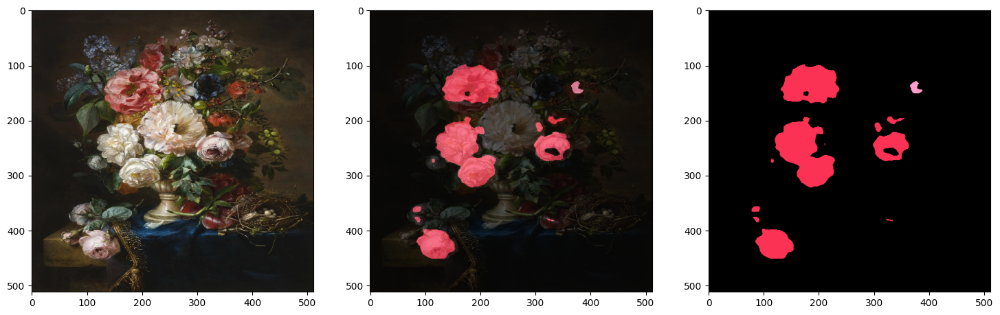

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


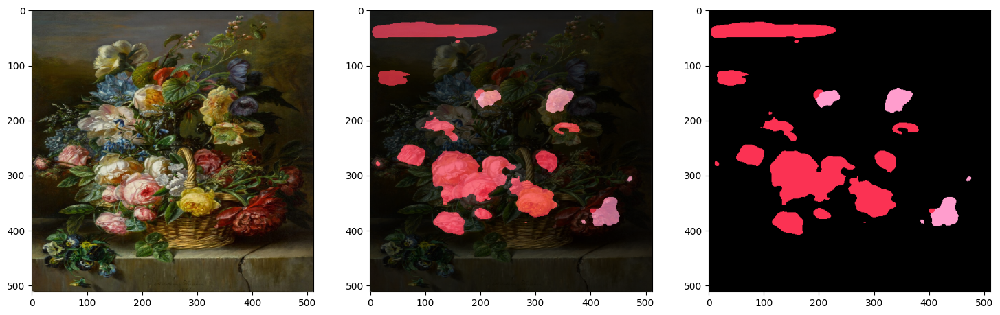

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 507ms/step


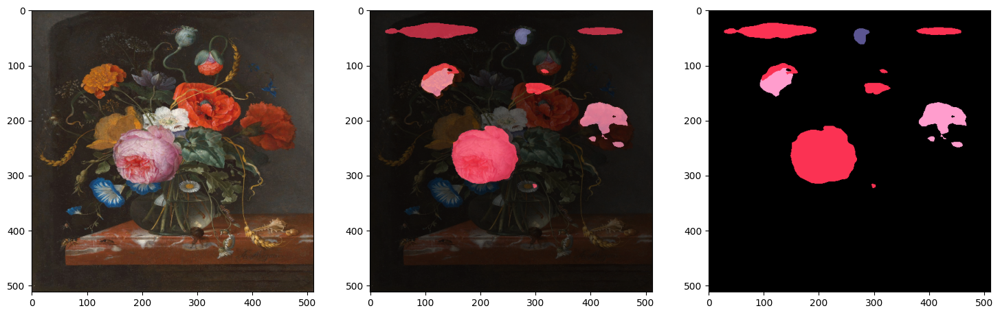

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


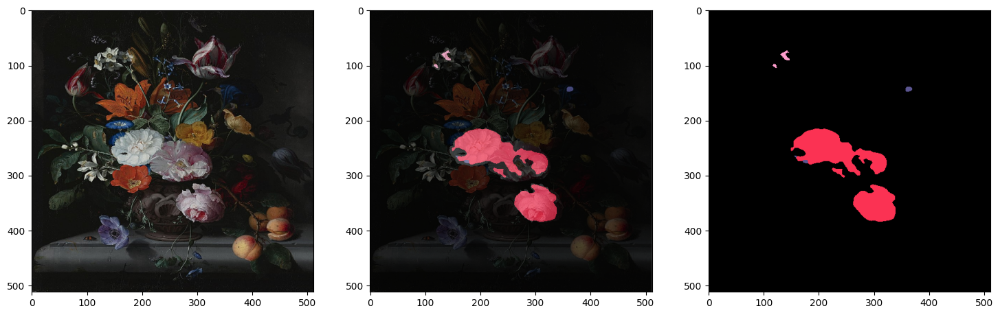

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step


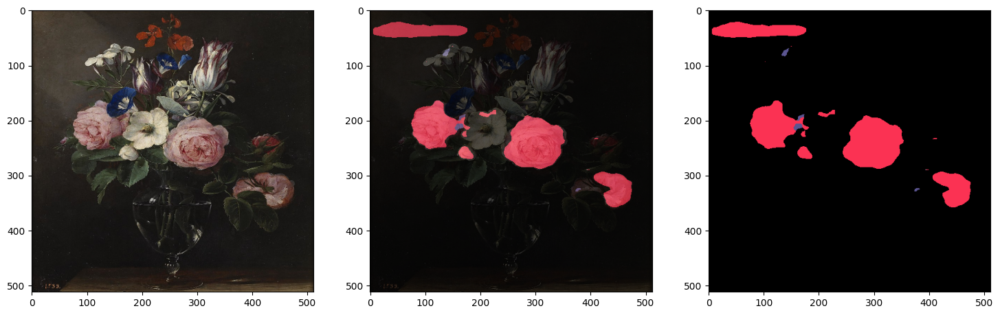

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 503ms/step


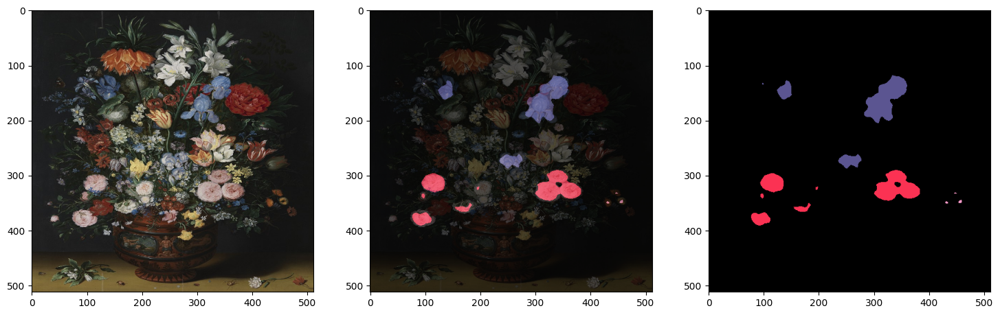

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step


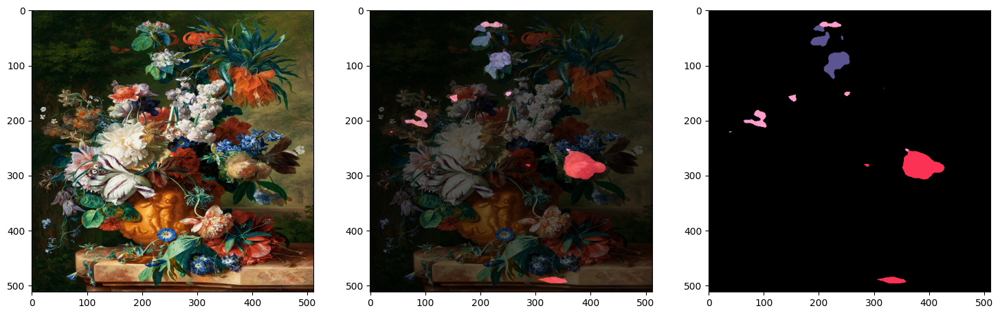

In [12]:
plot_predictions(val_images[20:30], colormap, "val", model=model)

## Inference on Testing Images

In [15]:
test_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[190 : 201]
test_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[190 : 201]

In [16]:
_predictions(test_images, colormap, "test", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 553ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 537ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 515ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 488ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 644ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 667ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 486ms/step


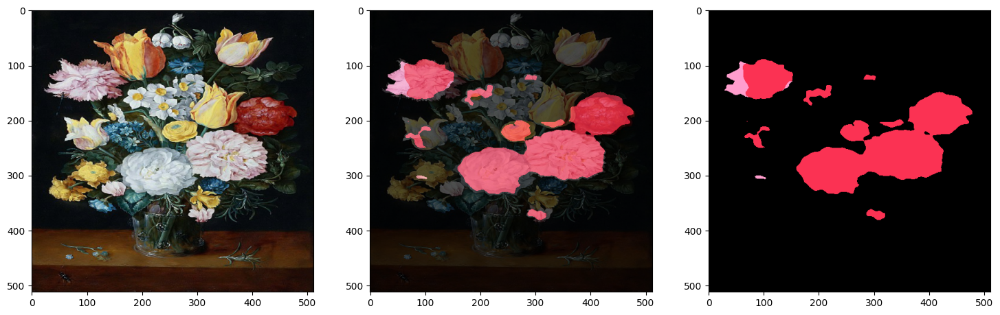

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 513ms/step


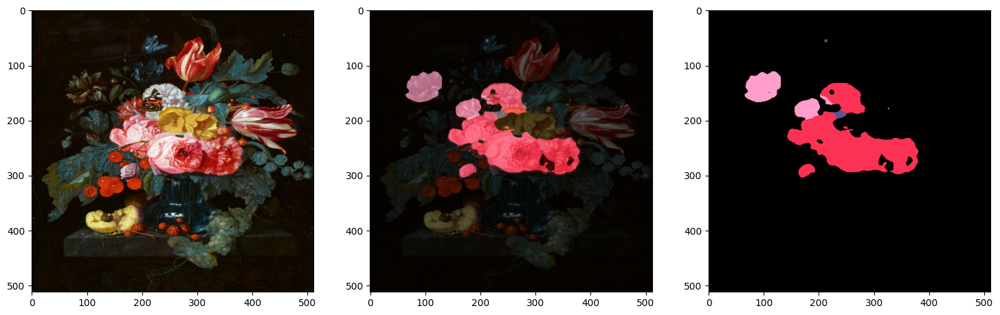

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 531ms/step


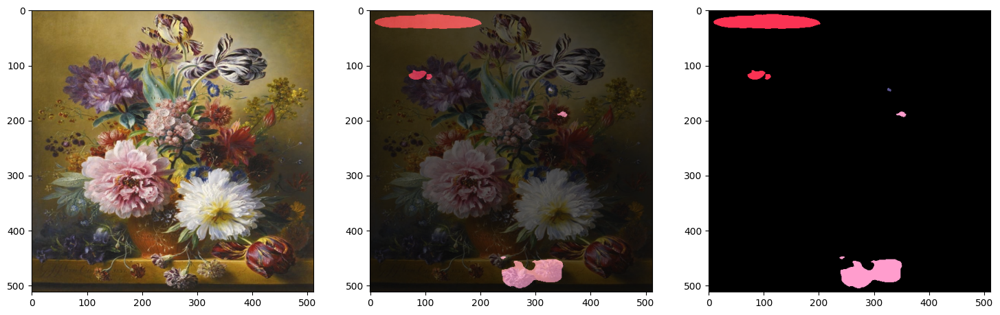

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 479ms/step


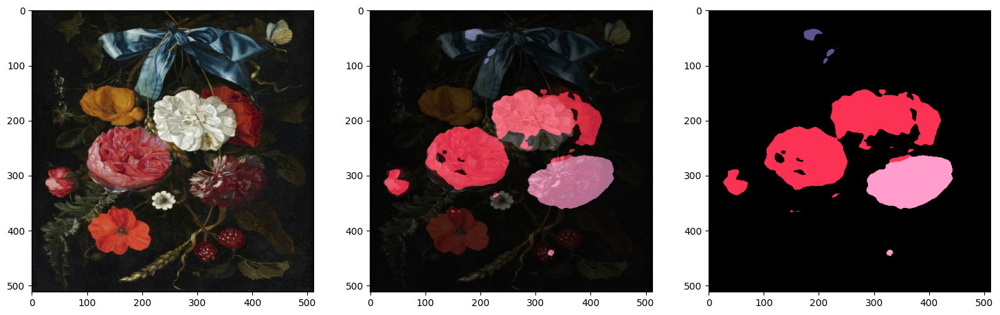

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 480ms/step


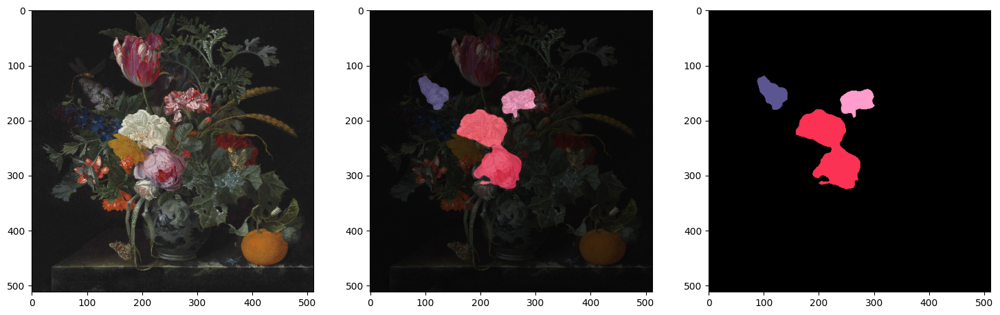

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 482ms/step


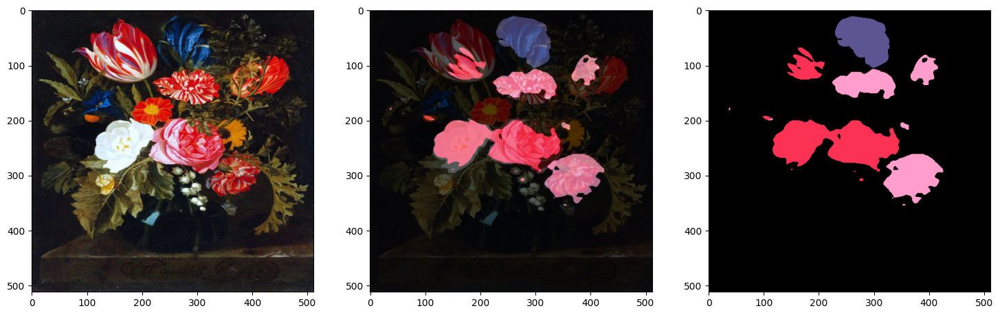

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step


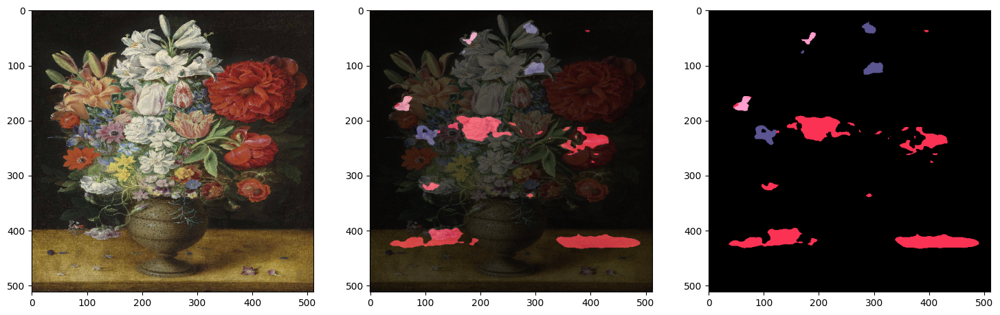

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step


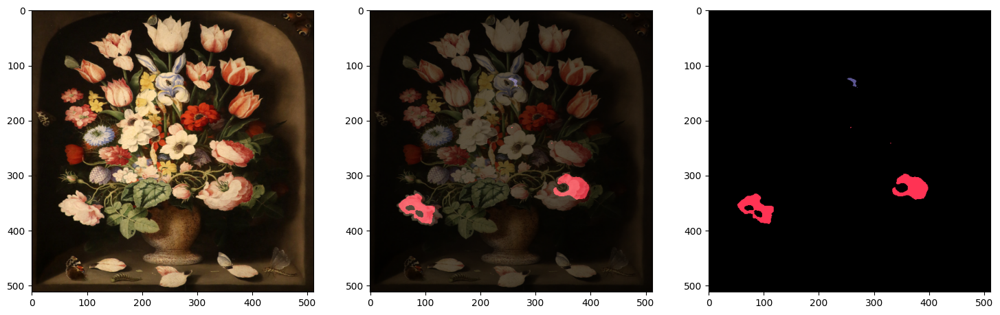

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step


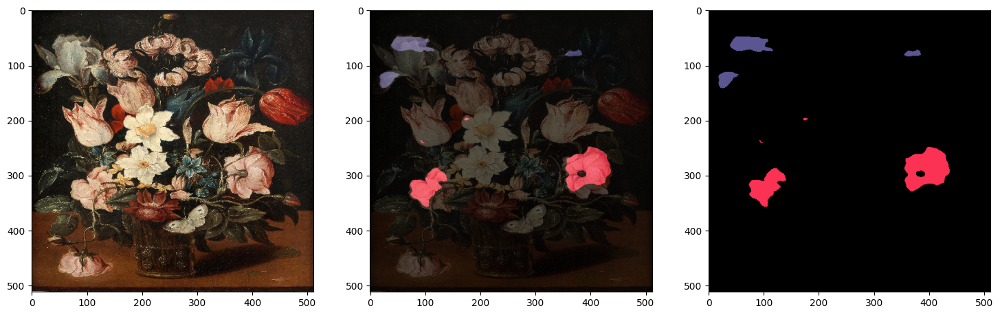

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


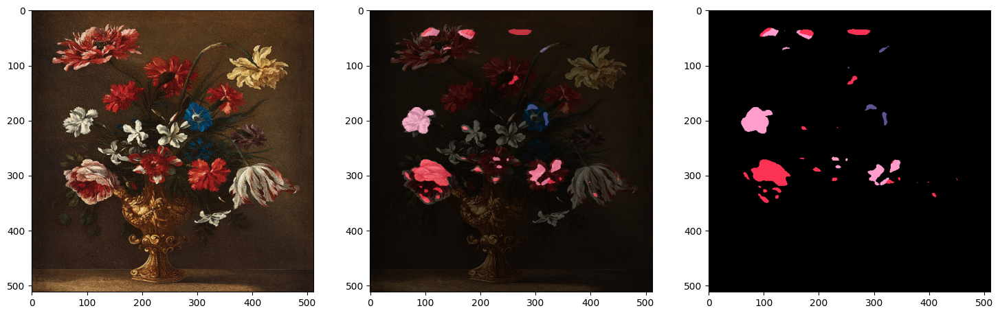

In [17]:
plot_predictions(test_images, colormap, "test", model=model)

# IOU for test

In [18]:
test_pred = sorted(glob(os.path.join(DATA_DIR, "test_pred/*")))
mask_color = sorted(glob(os.path.join(DATA_DIR, "mask_color/*")))[190 : 201]

In [19]:
# from pathlib import Path
# names = []
# for i in range(334):
#     path = Path(test_pred[i])
#     names.append(path.name)

# print(names)

In [20]:
# for i in range(334):
#     name = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes/mask_color/{names[i]}.png"
#     new_name = f"C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes/mask_color/{names[i]}"
#     # if name != new_name:
#     os.rename(name, new_name)

In [21]:
# for i in range(1, 101):
#     image = cv2.imread(f"C:/Users/iraor/PycharmProjects/FusionBrainGen/skeletons/mask_color/image{i}.png")
#     for k in range(image.shape[0]):
#         for l in range(image.shape[0]):
#             if list(image[k, l]) == [255, 241, 189]:
#                 image[k, l] = [255, 0, 0]
#     cv2.imwrite(f"C:/Users/iraor/PycharmProjects/FusionBrainGen/skeletons/mask_color/image{i}.png", image)

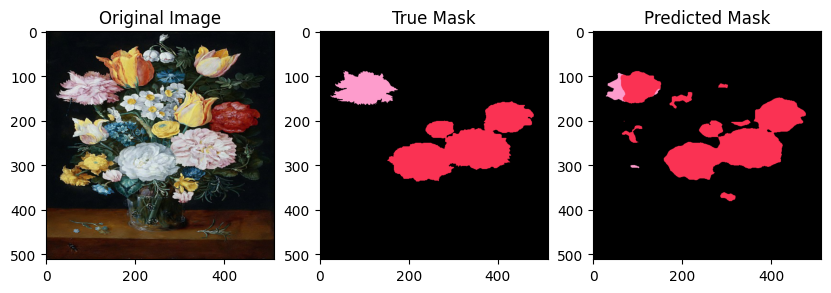

image0 IOU_carnation: 0.17772165359564004
image0 IOU_iris: 1
image0 IOU_peony: 0.7090650610469978
image0 IOU_back: 0.9680981541915324


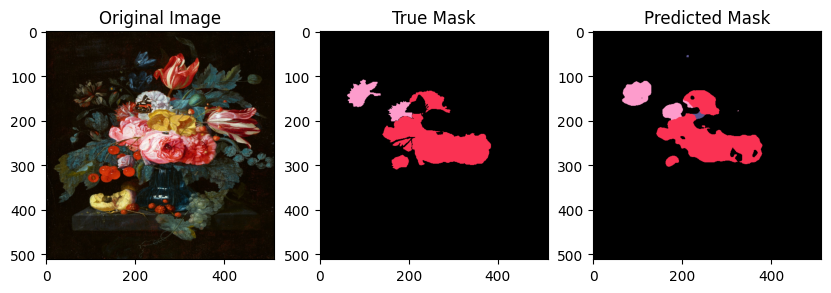

image1 IOU_carnation: 0.6580738296555991
image1 IOU_iris: 0.1
image1 IOU_peony: 0.793096384308102
image1 IOU_back: 0.9766449815272201


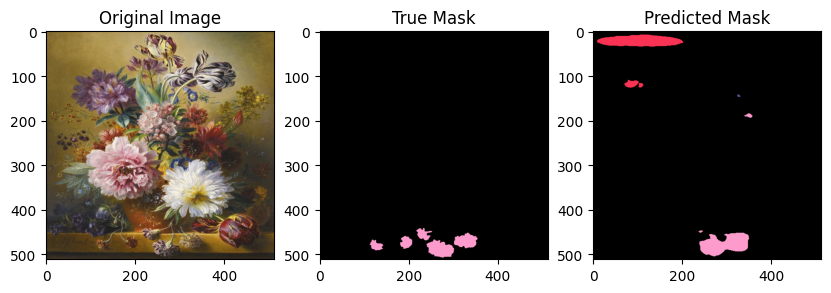

image2 IOU_carnation: 0.4627271183562574
image2 IOU_iris: 0.1
image2 IOU_peony: 0.1
image2 IOU_back: 0.9705418647053609


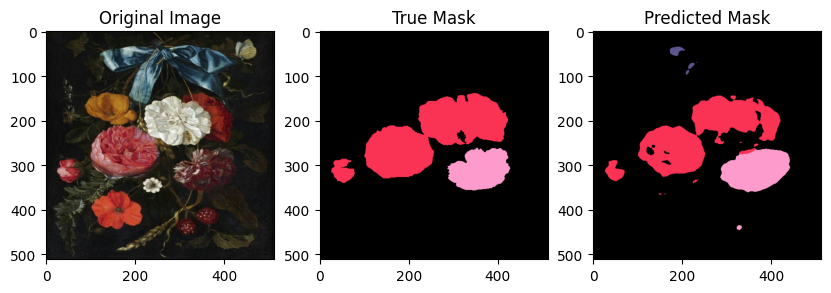

image3 IOU_carnation: 0.8242092457420924
image3 IOU_iris: 0.1
image3 IOU_peony: 0.7798683520708336
image3 IOU_back: 0.956913667789399


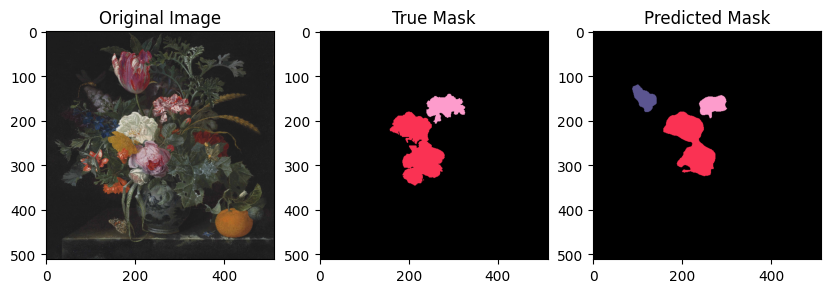

image4 IOU_carnation: 0.5811844715216775
image4 IOU_iris: 0.1
image4 IOU_peony: 0.7786182086523383
image4 IOU_back: 0.9769006405671324


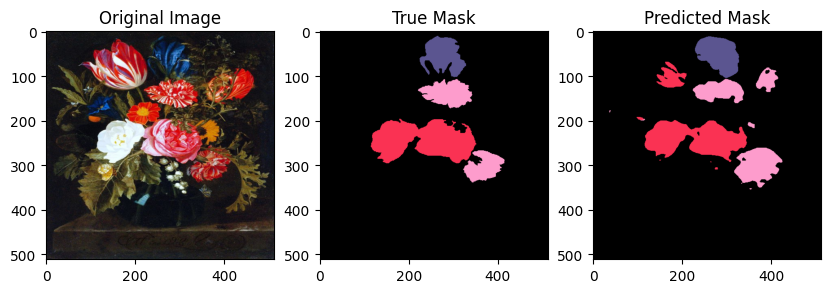

image5 IOU_carnation: 0.6009066868152626
image5 IOU_iris: 0.7347994825355757
image5 IOU_peony: 0.7222933481770109
image5 IOU_back: 0.949889174722513


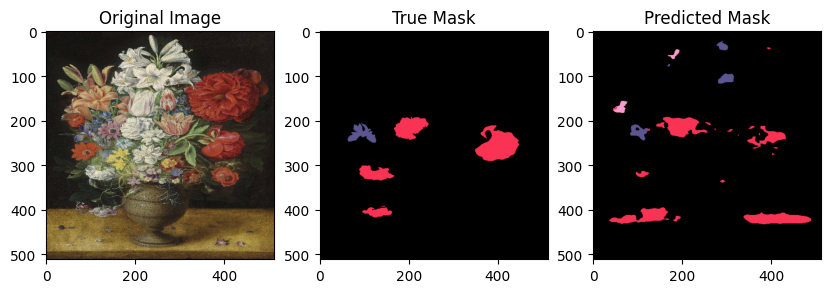

image6 IOU_carnation: 0.1
image6 IOU_iris: 0.26818545163868907
image6 IOU_peony: 0.27710090596688536
image6 IOU_back: 0.9452532310397684


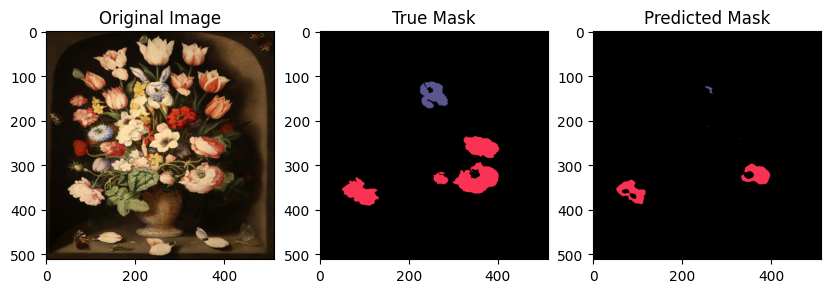

image7 IOU_carnation: 1
image7 IOU_iris: 0.045619701251513926
image7 IOU_peony: 0.33118177503559565
image7 IOU_back: 0.9636035924530637


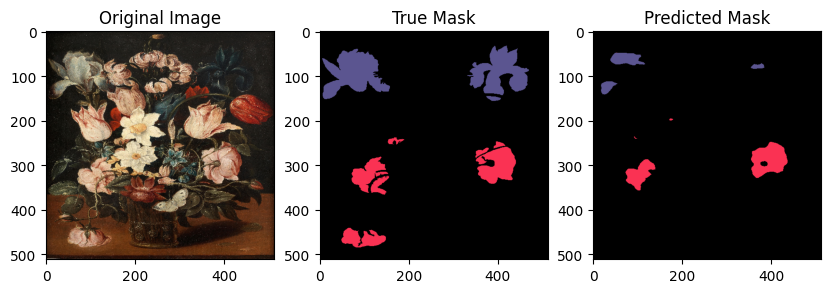

image8 IOU_carnation: 0.1
image8 IOU_iris: 0.14115341545352744
image8 IOU_peony: 0.4879962706860384
image8 IOU_back: 0.9134522775716428


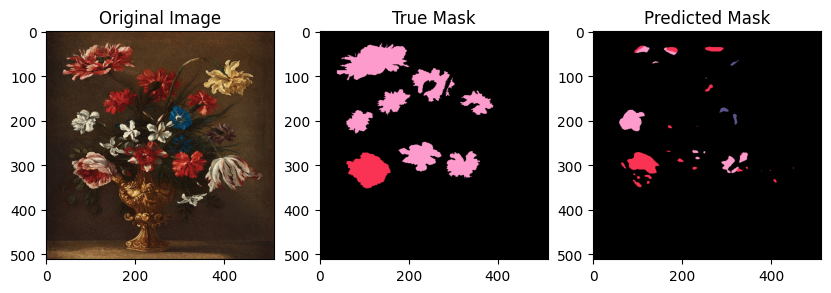

image9 IOU_carnation: 0.13460964482155802
image9 IOU_iris: 0.1
image9 IOU_peony: 0.39620212423559703
image9 IOU_back: 0.9099707616054536

 MIOU_carnation: 0.4639432650508087

 MIOU_iris: 0.2689758050879307

 MIOU_peony: 0.53754224301794

 MIOU_back: 0.9531268346173087

 MIOU for all classes: 0.6597931848433392


In [22]:
arr_carnation, arr_iris, arr_peony, arr_back = [], [], [], []

IOU_sum_back = 0
IOU_sum_carnation = 0
IOU_sum_iris = 0
IOU_sum_peony = 0


def claculate_IOU(true_mask, pred_mask, color):
    TP = 0 
    FP = 0
    FN = 0
    for k in range(true_mask.shape[0]):
        for l in range(true_mask.shape[1]):
            if (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) == color): 
                TP+=1
            elif (list(true_mask[k, l]) != color) and (list(pred_mask[k, l]) == color): 
                FP+=1
            elif (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) != color): 
                FN+=1

    if TP+FP+FN == 0: IOU = 1
    else: IOU = TP/(TP+FP+FN) 
    if IOU == 0: IOU = 0.1
    return IOU
    
for i in range(NUM_TEST_IMAGES):
    img = cv2.imread(test_images[i])
    true_mask = cv2.imread(mask_color[i])
    pred_mask = cv2.imread(test_pred[i])

    # IOU_scull = claculate_IOU(true_mask, pred_mask, [255, 0, 0])
    IOU_carnation = claculate_IOU(true_mask, pred_mask, [204, 156, 253])
    IOU_iris = claculate_IOU(true_mask, pred_mask, [144, 85, 91])
    IOU_peony = claculate_IOU(true_mask, pred_mask, [83, 50, 250])
    IOU_back = claculate_IOU(true_mask, pred_mask, [0, 0, 0])
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    true_mask = cv2.cvtColor(true_mask, cv2.COLOR_BGR2RGB)
    pred_mask = cv2.cvtColor(pred_mask, cv2.COLOR_BGR2RGB)
    fig, axs = plt.subplots(1, 3, figsize=(10, 5))
    axs[0].imshow(img)
    axs[0].set_title('Original Image')
    axs[1].imshow(true_mask)
    axs[1].set_title('True Mask')
    axs[2].imshow(pred_mask)
    axs[2].set_title('Predicted Mask')
    plt.show()
    
    # print(f"image{i} IOU_scull: {IOU_scull}")
    print(f"image{i} IOU_carnation: {IOU_carnation}")
    print(f"image{i} IOU_iris: {IOU_iris}")
    print(f"image{i} IOU_peony: {IOU_peony}")
    print(f"image{i} IOU_back: {IOU_back}")

    # arr_scull.append(IOU_scull)
    arr_carnation.append(IOU_carnation)
    arr_iris.append(IOU_iris)
    arr_peony.append(IOU_peony)
    arr_back.append(IOU_back)
    # IOU_sum_scull += IOU_scull
    IOU_sum_carnation += IOU_carnation
    IOU_sum_iris += IOU_iris
    IOU_sum_peony += IOU_peony
    IOU_sum_back += IOU_back

MIOU_carnation = IOU_sum_carnation / NUM_TEST_IMAGES
MIOU_iris = IOU_sum_iris / NUM_TEST_IMAGES
MIOU_peony = IOU_sum_peony / NUM_TEST_IMAGES
MIOU_back = IOU_sum_back / NUM_TEST_IMAGES

print(f"\n MIOU_carnation: {MIOU_carnation}")
print(f"\n MIOU_iris: {MIOU_iris}")
print(f"\n MIOU_peony: {MIOU_peony}")
print(f"\n MIOU_back: {MIOU_back}")
print(f"\n MIOU for all classes: {(MIOU_carnation+MIOU_iris+MIOU_back+MIOU_back)/4}")

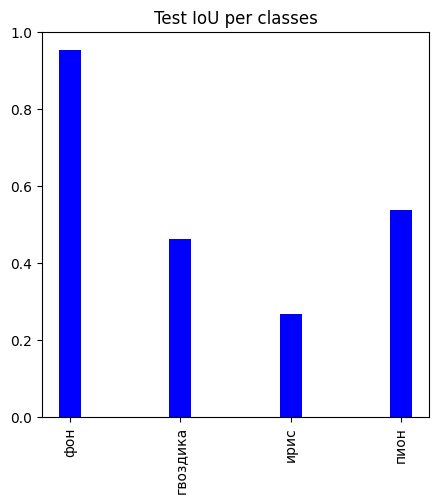

IOU фон: 0.9531268346173087, IOU гвоздика: 0.4639432650508087, IOU ирис: 0.2689758050879307, IOU пион: 0.53754224301794


In [23]:
сa = 0
ir = 0
pe = 0
ba = 0
for i in range(NUM_TEST_IMAGES):
    сa += arr_carnation[i]
    ir += arr_iris[i]
    pe += arr_peony[i]
    ba += arr_back[i]


values = [ba/NUM_TEST_IMAGES, сa/NUM_TEST_IMAGES, ir/NUM_TEST_IMAGES, pe/NUM_TEST_IMAGES]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (5, 5))
plt.title('Test IoU per classes')
plt.bar(x_axis, values, width=0.2, color='b')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.show()

print(f"IOU фон: {values[0]}, IOU гвоздика: {values[1]}, IOU ирис: {values[2]}, IOU пион: {values[3]}")

# Дополненый набор

In [24]:
DATA_DIR = "C:/Users/iraor/PycharmProjects/FusionBrainGen/join_classes"
NUM_TRAIN_IMAGES = 800
NUM_VAL_IMAGES = 200

train_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[:NUM_TRAIN_IMAGES]
train_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[:NUM_TRAIN_IMAGES]
val_images = sorted(glob(os.path.join(DATA_DIR, "original/*")))[NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]
val_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES]

train_dataset = data_generator(train_images, train_masks)
val_dataset = data_generator(val_images, val_masks)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)

Train Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 512, 512, 1), dtype=tf.float32, name=None))>
Val Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 512, 512, 1), dtype=tf.float32, name=None))>


In [25]:
history = model.fit(train_dataset, validation_data=val_dataset, epochs=5)

Epoch 1/5
200/200 ━━━━━━━━━━━━━━━━━━━━ 2435s 12s/step - MIoU: 0.7838 - accuracy: 0.9449 - loss: 0.1681 - гвоздика: 0.6502 - ирис: 0.7309 - пион: 0.8081 - фон: 0.9460 - val_MIoU: 0.8297 - val_accuracy: 0.9772 - val_loss: 0.0672 - val_гвоздика: 0.6760 - val_ирис: 0.8643 - val_пион: 0.7941 - val_фон: 0.9845
Epoch 2/5
200/200 ━━━━━━━━━━━━━━━━━━━━ 2420s 12s/step - MIoU: 0.9052 - accuracy: 0.9770 - loss: 0.0600 - гвоздика: 0.8638 - ирис: 0.8705 - пион: 0.9107 - фон: 0.9757 - val_MIoU: 0.8001 - val_accuracy: 0.9698 - val_loss: 0.0896 - val_гвоздика: 0.6318 - val_ирис: 0.8302 - val_пион: 0.7641 - val_фон: 0.9745
Epoch 3/5
200/200 ━━━━━━━━━━━━━━━━━━━━ 2426s 12s/step - MIoU: 0.9187 - accuracy: 0.9800 - loss: 0.0516 - гвоздика: 0.8846 - ирис: 0.8893 - пион: 0.9229 - фон: 0.9781 - val_MIoU: 0.8881 - val_accuracy: 0.9836 - val_loss: 0.0438 - val_гвоздика: 0.8094 - val_ирис: 0.8866 - val_пион: 0.8707 - val_фон: 0.9858
Epoch 4/5
200/200 ━━━━━━━━━━━━━━━━━━━━ 2418s 12s/step - MIoU: 0.9304 - accuracy: 0

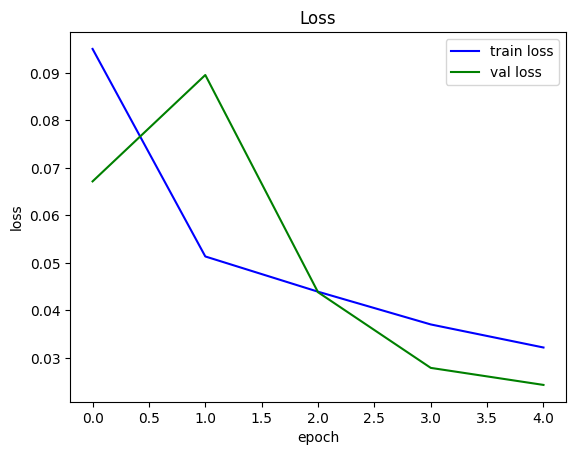

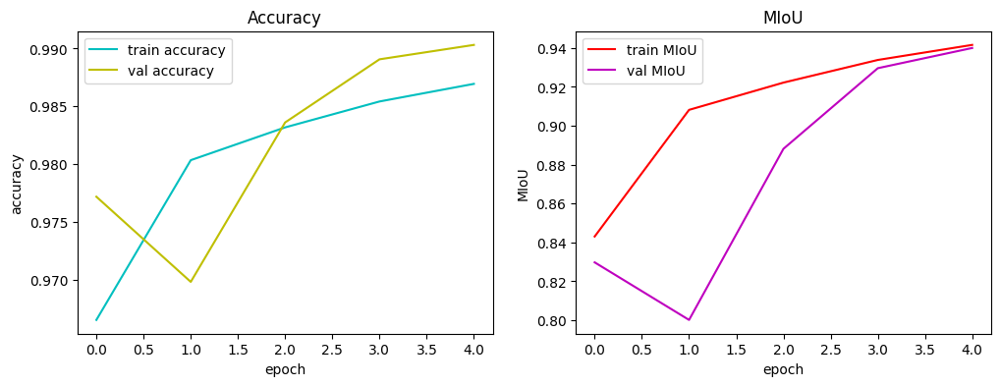

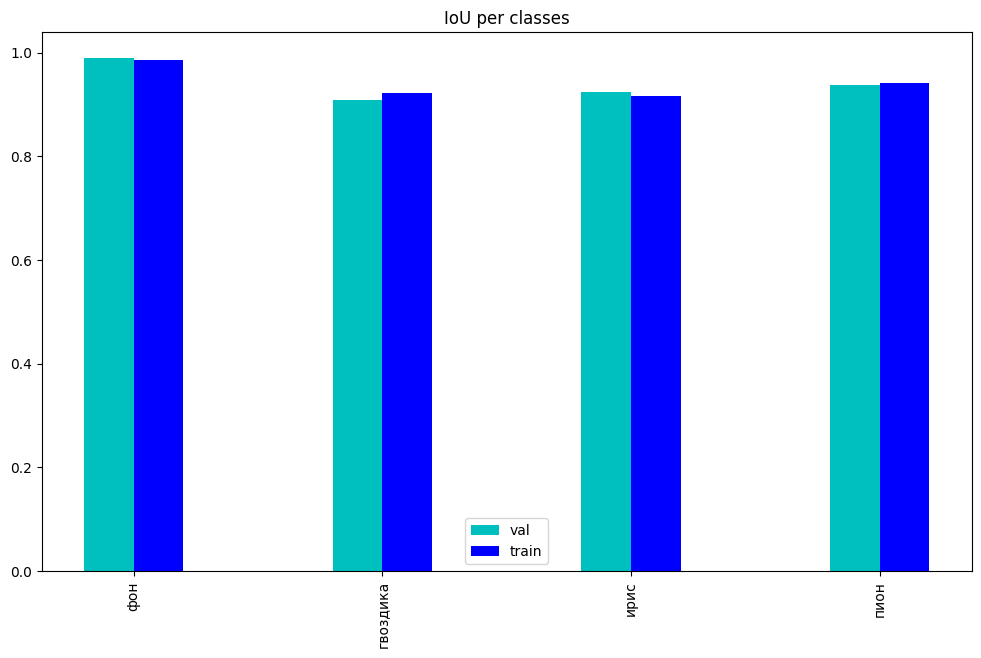

In [26]:
plt.plot(history.history["loss"], label = 'train loss', color = 'b')
plt.plot(history.history["val_loss"], label = 'val loss', color = 'g')
plt.title("Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.legend()
plt.show()


fig, axs = plt.subplots(1, 2, figsize=(12, 4))
axs[0].plot(history.history["accuracy"], label = 'train accuracy', color = 'c')
axs[0].plot(history.history["val_accuracy"], label = 'val accuracy', color = 'y')
axs[0].set_title("Accuracy")
axs[0].set_ylabel("accuracy")
axs[0].set_xlabel("epoch")
axs[0].legend()
axs[1].plot(history.history["MIoU"], label = 'train MIoU', color = 'r')
axs[1].plot(history.history["val_MIoU"], label = 'val MIoU', color = 'm')
axs[1].set_title("MIoU")
axs[1].set_ylabel("MIoU")
axs[1].set_xlabel("epoch")
axs[1].legend()
plt.show()

# fig, axs = plt.subplots(1, 2, figsize=(12, 4))
# axs[0].plot(history.history["фон"], label = 'фон IoU', color = 'black')
# axs[0].plot(history.history["череп"], label = 'череп IoU', color = 'b')
# axs[0].set_title("Train IOU per classes")
# axs[0].set_ylabel("IoU")
# axs[0].set_xlabel("epoch")
# axs[0].legend()
# axs[1].plot(history.history["val_фон"], label = 'фон IoU', color = 'black')
# axs[1].plot(history.history["val_череп"], label = 'череп IoU', color = 'b')
# axs[1].set_title("Val IOU per classes")
# axs[1].set_ylabel("IoU")
# axs[1].set_xlabel("epoch")
# axs[1].legend()
# plt.show()

train_values = [history.history["фон"][4], history.history["гвоздика"][4], history.history["ирис"][4], history.history["пион"][4]]
val_values = [history.history["val_фон"][4], history.history["val_гвоздика"][4], history.history["val_ирис"][4], history.history["val_пион"][4]]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (12, 7))
plt.title('IoU per classes')
plt.bar(x_axis-0.1, val_values, width=0.2, color='c', label='val')
plt.bar(x_axis+0.1, train_values, width=0.2, color='b', label='train')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.legend()
plt.show()

In [27]:
_predictions(test_images, colormap, "test", model=model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 713ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 519ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 536ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 497ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 499ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 538ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 546ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 566ms/step


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 484ms/step


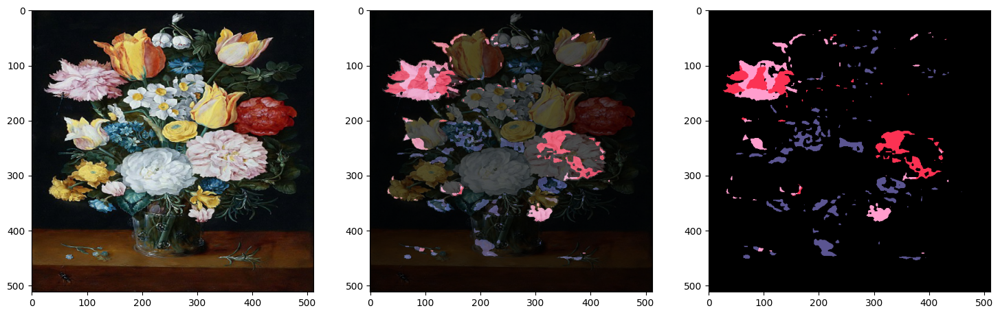

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step


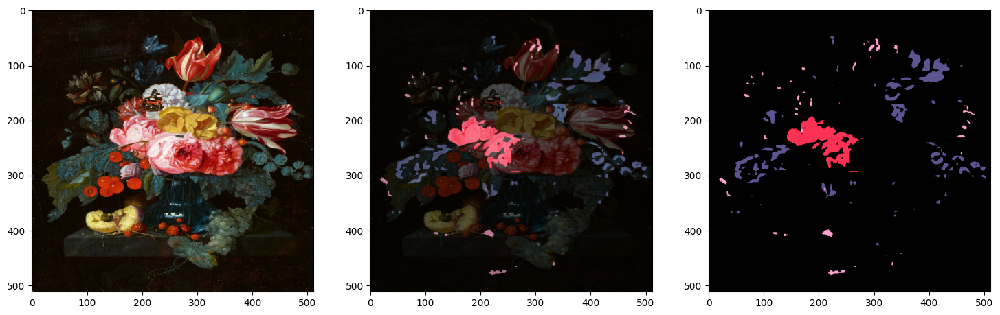

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 492ms/step


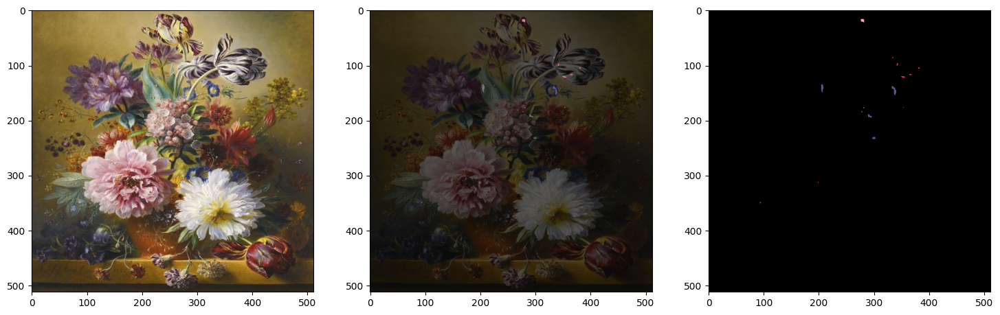

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 534ms/step


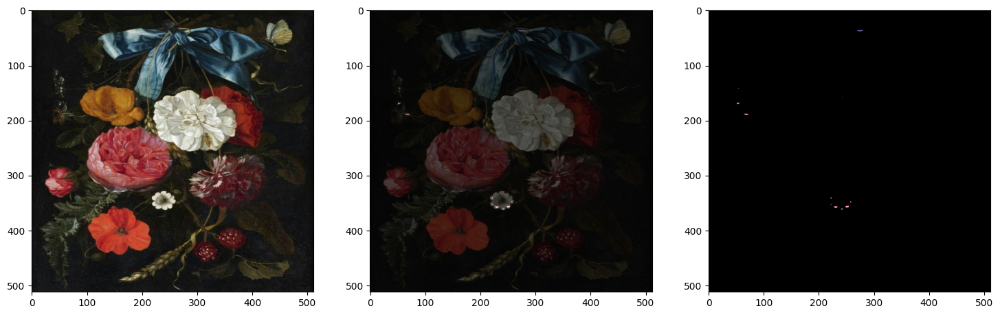

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 558ms/step


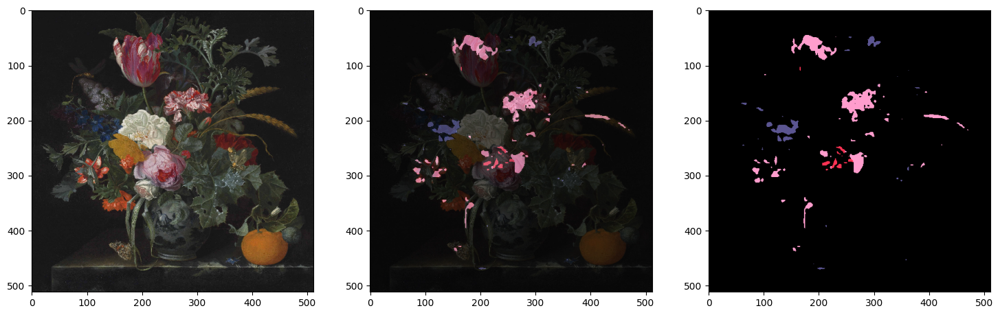

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 494ms/step


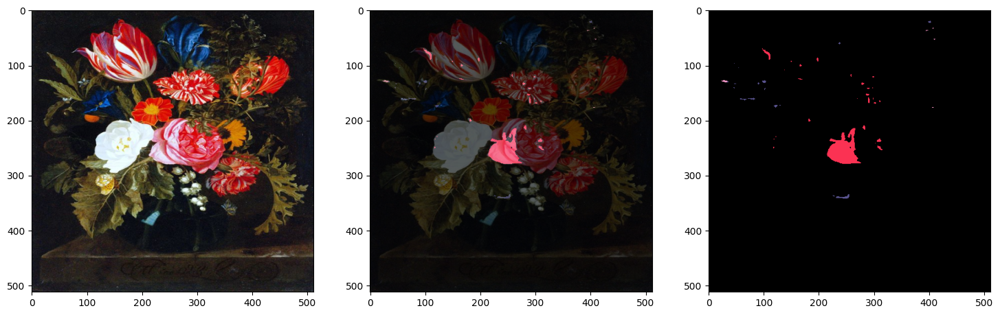

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 577ms/step


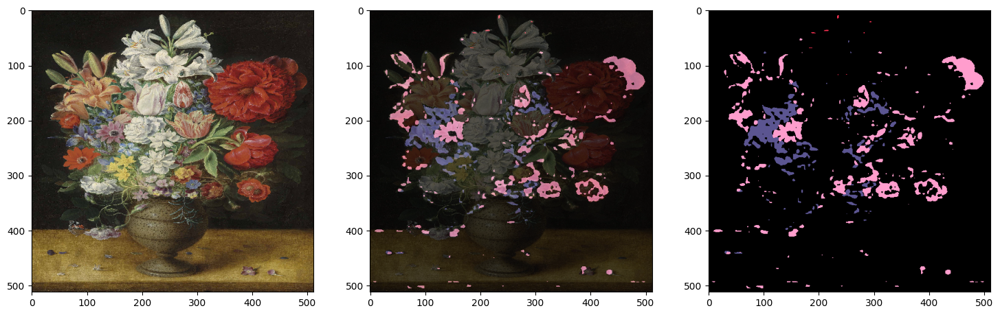

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 525ms/step


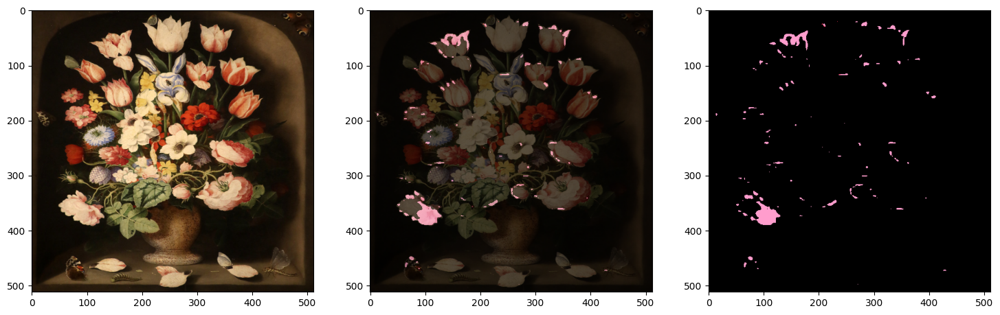

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 523ms/step


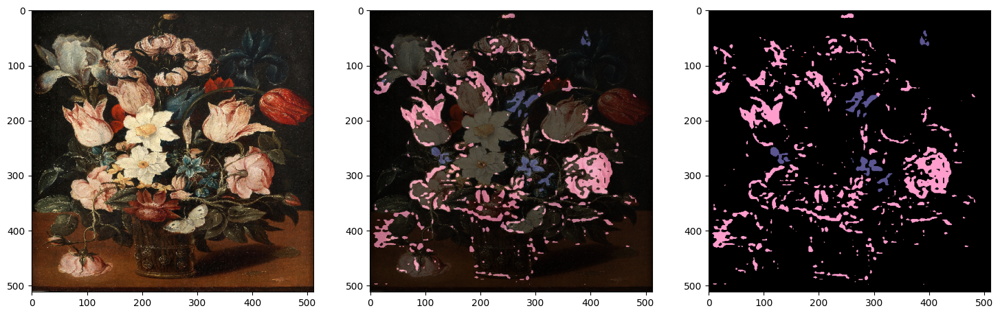

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 508ms/step


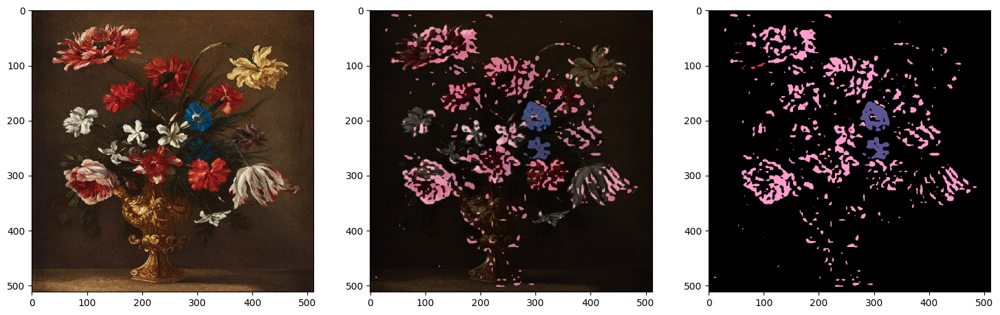

In [28]:
plot_predictions(test_images, colormap, "test", model=model)

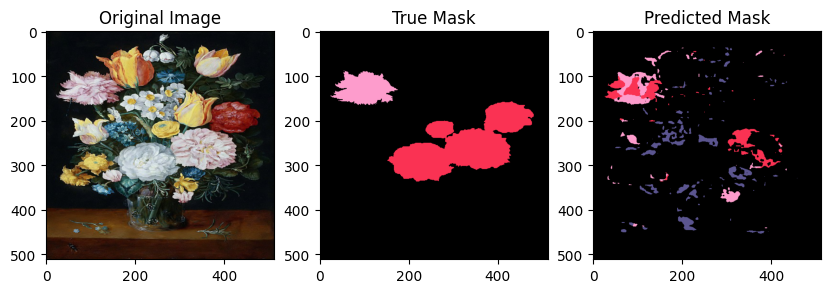

image0 IOU_carnation: 0.3209838107098381
image0 IOU_iris: 0.1
image0 IOU_peony: 0.08602635564004253
image0 IOU_back: 0.8610159321659219


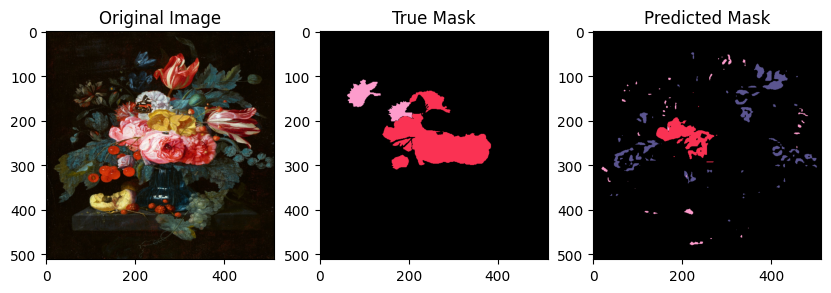

image1 IOU_carnation: 0.03528683450268263
image1 IOU_iris: 0.1
image1 IOU_peony: 0.26618863761720907
image1 IOU_back: 0.905744399502178


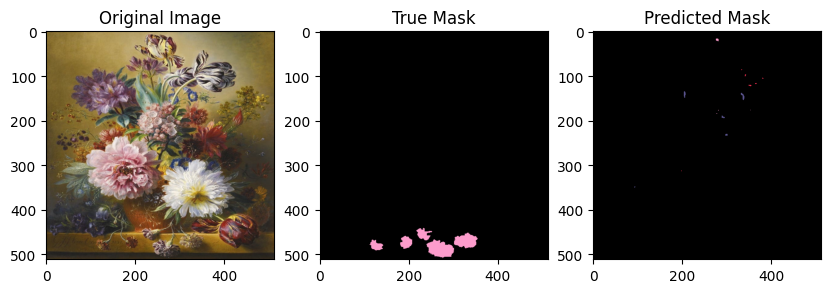

image2 IOU_carnation: 0.1
image2 IOU_iris: 0.1
image2 IOU_peony: 0.1
image2 IOU_back: 0.9817962646484375


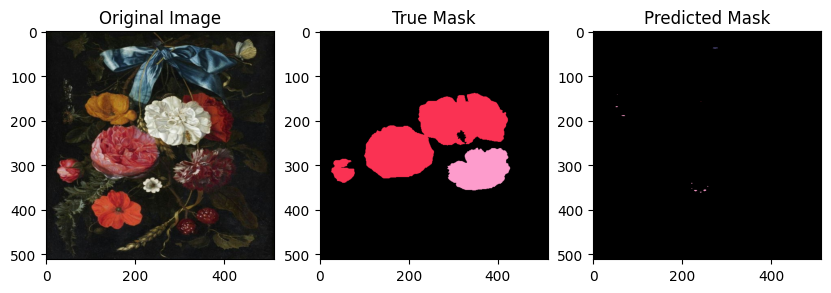

image3 IOU_carnation: 0.1
image3 IOU_iris: 0.1
image3 IOU_peony: 2.9632263608617062e-05
image3 IOU_back: 0.8332970935710662


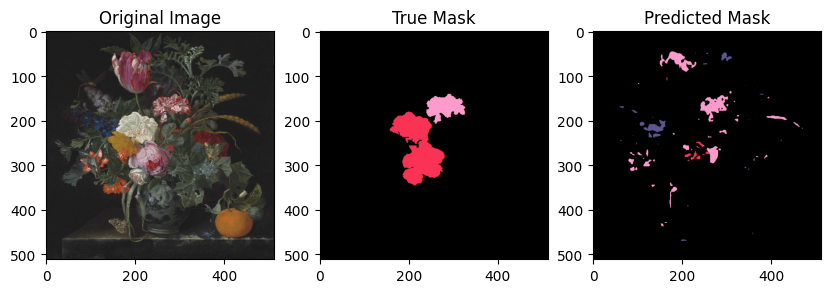

image4 IOU_carnation: 0.2497093023255814
image4 IOU_iris: 0.1
image4 IOU_peony: 0.035034846487097385
image4 IOU_back: 0.9402857924824319


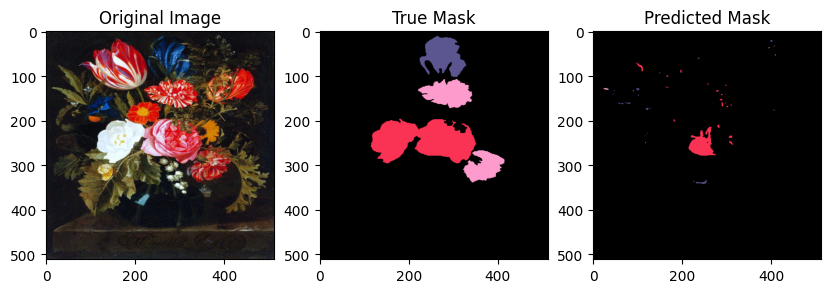

image5 IOU_carnation: 0.1
image5 IOU_iris: 0.0014947683109118087
image5 IOU_peony: 0.1431980906921241
image5 IOU_back: 0.8897294342295728


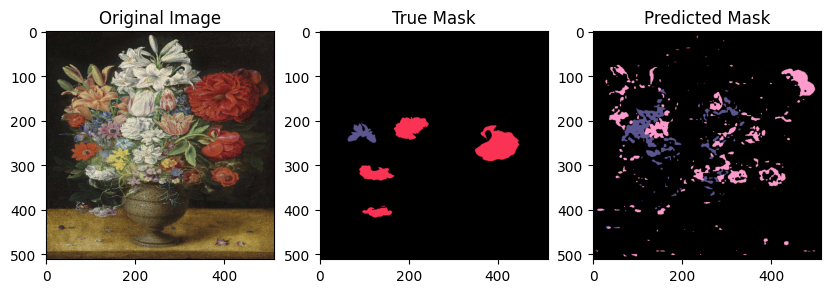

image6 IOU_carnation: 0.1
image6 IOU_iris: 0.15767692095461444
image6 IOU_peony: 0.1
image6 IOU_back: 0.889694029507039


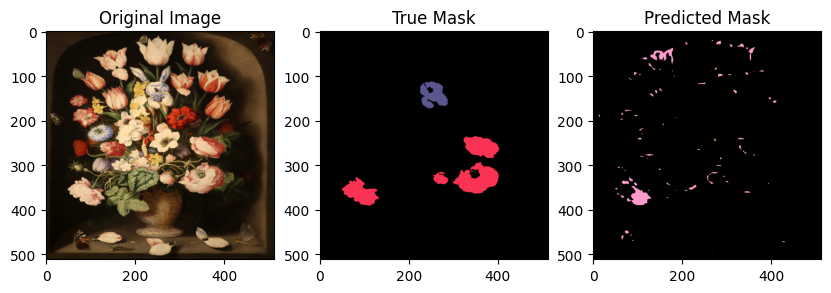

image7 IOU_carnation: 0.1
image7 IOU_iris: 0.1
image7 IOU_peony: 0.1
image7 IOU_back: 0.9490235822075833


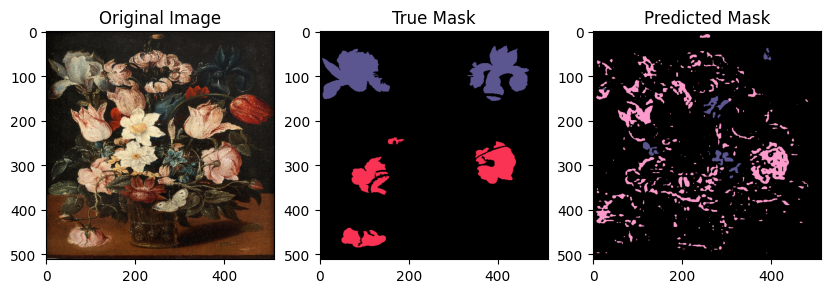

image8 IOU_carnation: 0.1
image8 IOU_iris: 0.011060410673544291
image8 IOU_peony: 0.1
image8 IOU_back: 0.8470481145363733


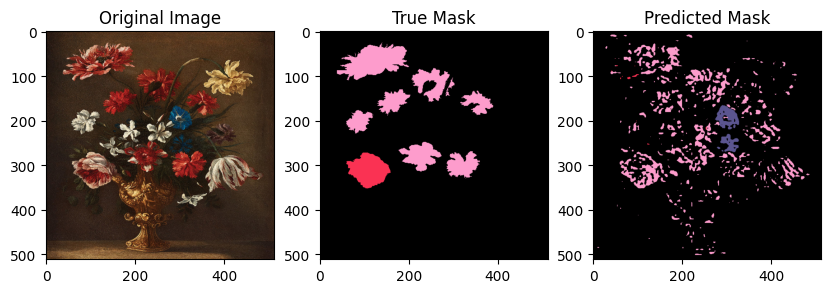

image9 IOU_carnation: 0.238564969761024
image9 IOU_iris: 0.1
image9 IOU_peony: 0.1
image9 IOU_back: 0.8873517393397552

 MIOU_carnation: 0.14445449172991262

 MIOU_iris: 0.08702320999390703

 MIOU_peony: 0.10304775627000817

 MIOU_back: 0.8984986382190359

 MIOU for all classes: 0.5071187445404728


In [30]:
arr_carnation, arr_iris, arr_peony, arr_back = [], [], [], []

IOU_sum_back = 0
IOU_sum_carnation = 0
IOU_sum_iris = 0
IOU_sum_peony = 0


def claculate_IOU(true_mask, pred_mask, color):
    TP = 0 
    FP = 0
    FN = 0
    for k in range(true_mask.shape[0]):
        for l in range(true_mask.shape[1]):
            if (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) == color): 
                TP+=1
            elif (list(true_mask[k, l]) != color) and (list(pred_mask[k, l]) == color): 
                FP+=1
            elif (list(true_mask[k, l]) == color) and (list(pred_mask[k, l]) != color): 
                FN+=1

    if TP+FP+FN == 0: IOU = 1
    else: IOU = TP/(TP+FP+FN) 
    if IOU == 0: IOU = 0.1
    return IOU
    
for i in range(NUM_TEST_IMAGES):
    img = cv2.imread(test_images[i])
    true_mask = cv2.imread(mask_color[i])
    pred_mask = cv2.imread(test_pred[i])

    # IOU_scull = claculate_IOU(true_mask, pred_mask, [255, 0, 0])
    IOU_carnation = claculate_IOU(true_mask, pred_mask, [204, 156, 253])
    IOU_iris = claculate_IOU(true_mask, pred_mask, [144, 85, 91])
    IOU_peony = claculate_IOU(true_mask, pred_mask, [83, 50, 250])
    IOU_back = claculate_IOU(true_mask, pred_mask, [0, 0, 0])
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    true_mask = cv2.cvtColor(true_mask, cv2.COLOR_BGR2RGB)
    pred_mask = cv2.cvtColor(pred_mask, cv2.COLOR_BGR2RGB)
    fig, axs = plt.subplots(1, 3, figsize=(10, 5))
    axs[0].imshow(img)
    axs[0].set_title('Original Image')
    axs[1].imshow(true_mask)
    axs[1].set_title('True Mask')
    axs[2].imshow(pred_mask)
    axs[2].set_title('Predicted Mask')
    plt.show()
    
    # print(f"image{i} IOU_scull: {IOU_scull}")
    print(f"image{i} IOU_carnation: {IOU_carnation}")
    print(f"image{i} IOU_iris: {IOU_iris}")
    print(f"image{i} IOU_peony: {IOU_peony}")
    print(f"image{i} IOU_back: {IOU_back}")

    # arr_scull.append(IOU_scull)
    arr_carnation.append(IOU_carnation)
    arr_iris.append(IOU_iris)
    arr_peony.append(IOU_peony)
    arr_back.append(IOU_back)
    # IOU_sum_scull += IOU_scull
    IOU_sum_carnation += IOU_carnation
    IOU_sum_iris += IOU_iris
    IOU_sum_peony += IOU_peony
    IOU_sum_back += IOU_back

MIOU_carnation = IOU_sum_carnation / NUM_TEST_IMAGES
MIOU_iris = IOU_sum_iris / NUM_TEST_IMAGES
MIOU_peony = IOU_sum_peony / NUM_TEST_IMAGES
MIOU_back = IOU_sum_back / NUM_TEST_IMAGES

print(f"\n MIOU_carnation: {MIOU_carnation}")
print(f"\n MIOU_iris: {MIOU_iris}")
print(f"\n MIOU_peony: {MIOU_peony}")
print(f"\n MIOU_back: {MIOU_back}")
print(f"\n MIOU for all classes: {(MIOU_carnation+MIOU_iris+MIOU_back+MIOU_back)/4}")

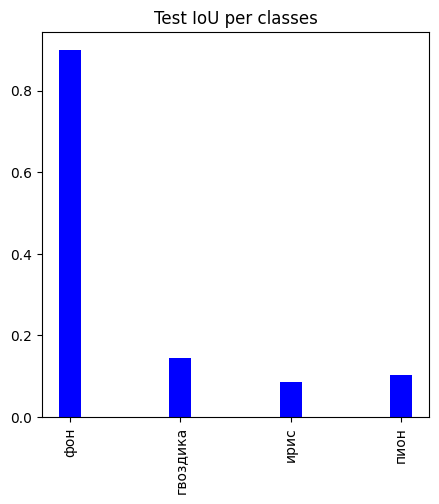

IOU фон: 0.8984986382190359, IOU гвоздика: 0.14445449172991262, IOU ирис: 0.08702320999390703, IOU пион: 0.10304775627000817


In [31]:
сa = 0
ir = 0
pe = 0
ba = 0
for i in range(NUM_TEST_IMAGES):
    сa += arr_carnation[i]
    ir += arr_iris[i]
    pe += arr_peony[i]
    ba += arr_back[i]


values = [ba/NUM_TEST_IMAGES, сa/NUM_TEST_IMAGES, ir/NUM_TEST_IMAGES, pe/NUM_TEST_IMAGES]
x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (5, 5))
plt.title('Test IoU per classes')
plt.bar(x_axis, values, width=0.2, color='b')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.show()

print(f"IOU фон: {values[0]}, IOU гвоздика: {values[1]}, IOU ирис: {values[2]}, IOU пион: {values[3]}")

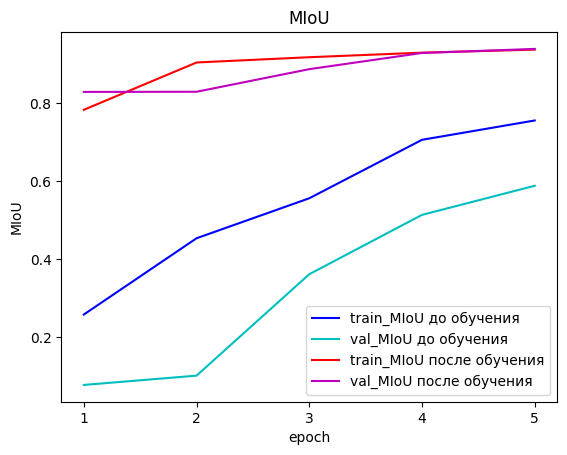

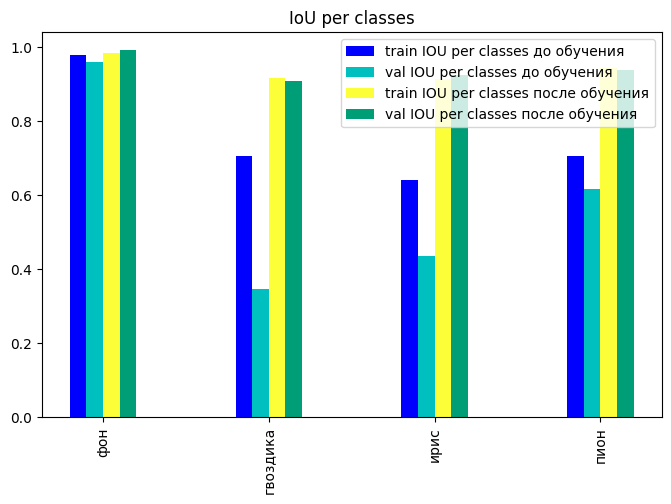

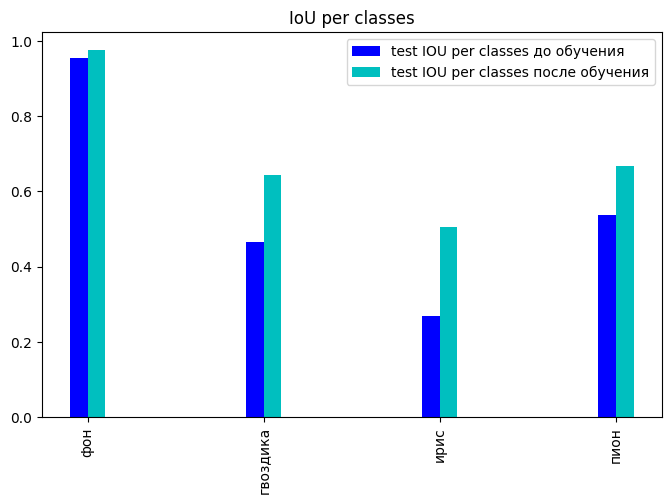

In [46]:
MIOU_train_old = [0.2585, 0.4542, 0.5568, 0.7068, 0.7564]
MIOU_val_old = [0.0779, 0.1017, 0.3620, 0.5142, 0.5889]
IOU_train_old = [0.9778, 0.7040, 0.6399, 0.7040]
IOU_val_old = [0.9585, 0.3444, 0.4357, 0.6168]
IOU_test_old = [0.9531, 0.4639, 0.2690, 0.5375]


MIOU_train_new = [0.7838, 0.9052, 0.9187, 0.9304, 0.9382]
MIOU_val_new = [0.8297, 0.8301, 0.8881, 0.9296, 0.9400]
IOU_train_new = [0.9822, 0.9165, 0.9125, 0.9418]
IOU_val_new = [0.9902, 0.9080, 0.9240, 0.9378]
IOU_test_new = [0.9745, 0.6421, 0.5041, 0.6683]



x = epochs = np.arange(1, 6)
plt.plot(epochs, MIOU_train_old,  label = 'train_MIoU до обучения', color = 'b')
plt.plot(epochs, MIOU_val_old,  label = 'val_MIoU до обучения', color = 'c')
plt.plot(epochs, MIOU_train_new,  label = 'train_MIoU после обучения', color = 'r')
plt.plot(epochs, MIOU_val_new,  label = 'val_MIoU после обучения', color = 'm')
plt.xticks(np.arange(min(x), max(x)+1, 1.0))
plt.title("MIoU")
plt.ylabel("MIoU")
plt.xlabel("epoch")
plt.legend()
plt.show()


x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (8, 5))
plt.title('IoU per classes')
plt.bar(x_axis-0.15, IOU_train_old, width=0.10, color='b', label='train IOU per classes до обучения')
plt.bar(x_axis-0.05, IOU_val_old, width=0.10, color='c', label='val IOU per classes до обучения')
plt.bar(x_axis+0.05, IOU_train_new, width=0.10, color='#fcff38', label='train IOU per classes после обучения')
plt.bar(x_axis+0.15, IOU_val_new, width=0.10, color='#009e77', label='val IOU per classes после обучения')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.legend()
plt.show()


x_axis = np.arange(len(CLASSES))
plt.figure(figsize = (8, 5))
plt.title('IoU per classes')
plt.bar(x_axis-0.05, IOU_test_old, width=0.1, color='b', label='test IOU per classes до обучения')
plt.bar(x_axis+0.05, IOU_test_new, width=0.1, color='c', label='test IOU per classes после обучения')
plt.xticks(x_axis, CLASSES, rotation=90)
plt.legend()
plt.show()